In [172]:
!pip install requests
!pip install pandas
!pip install numpy
!pip install matplotlib


[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [173]:
import requests
import pandas
import numpy
import datetime
import time
import matplotlib.pyplot as plt

In [176]:
api_key = "0a15cda0325147be8e3104950252211" # free api key from https://www.worldweatheronline.com/weather-api/

In [177]:
start_year = 2010
end_year = 2020

start_day = 1
end_day = 1

start_month = 1
end_month = 12

start_date = datetime.datetime.strptime(f"{start_year}-{start_month}-{start_day}", '%Y-%m-%d')
end_date = datetime.datetime.strptime(f"{end_year}-{end_month}-{end_day}", '%Y-%m-%d')

city = "New-York"

chunk_days = 15

all_weather = []

In [178]:
print(start_date.date())
print(end_date.date())

current_date = start_date

session = requests.Session()

while (current_date < end_date):
    next_date = min(end_date, current_date + datetime.timedelta(days=chunk_days))
    str_request = f"https://api.worldweatheronline.com/premium/v1/past-weather.ashx?key={api_key}&q={city}&format=json&date={current_date.date()}&enddate={next_date.date()}"
    request = session.get(str_request).json()['data']['weather']
    for current_weather in request:
        print(current_weather)
        all_weather.append(current_weather)
    current_date = next_date + datetime.timedelta(days=1)
    time.sleep(0.5)

2010-01-01
2020-12-01
{'date': '2010-01-01', 'astronomy': [{'sunrise': '07:20 AM', 'sunset': '04:39 PM', 'moonrise': '05:56 PM', 'moonset': '08:04 AM', 'moon_phase': 'Full Moon', 'moon_illumination': '100'}], 'maxtempC': '4', 'maxtempF': '39', 'mintempC': '-1', 'mintempF': '31', 'avgtempC': '1', 'avgtempF': '34', 'totalSnow_cm': '0.4', 'sunHour': '6.0', 'uvIndex': '1', 'hourly': [{'time': '0', 'tempC': '-0', 'tempF': '32', 'windspeedMiles': '1', 'windspeedKmph': '1', 'winddirDegree': '323', 'winddir16Point': 'NW', 'weatherCode': '329', 'weatherIconUrl': [{'value': 'https://cdn.worldweatheronline.com/images/wsymbols01_png_64/wsymbol_0036_cloudy_with_heavy_snow_night.png'}], 'weatherDesc': [{'value': 'Patchy moderate snow'}], 'precipMM': '0.5', 'precipInches': '0.0', 'humidity': '97', 'visibility': '7', 'visibilityMiles': '4', 'pressure': '1015', 'pressureInches': '30', 'cloudcover': '84', 'HeatIndexC': '-0', 'HeatIndexF': '32', 'DewPointC': '-1', 'DewPointF': '31', 'WindChillC': '-0', '

In [179]:
print(len(all_weather))

3988


In [180]:
df = pandas.DataFrame(all_weather)

In [181]:
df

,date,astronomy,maxtempC,maxtempF,mintempC,mintempF,avgtempC,avgtempF,totalSnow_cm,sunHour,uvIndex,hourly
0,2010-01-01,"[{'sunrise': '07:20 AM', 'sunset': '04:39 PM',...",4,39,-1,31,1,34,0.4,6.0,1,"[{'time': '0', 'tempC': '-0', 'tempF': '32', '..."
1,2010-01-02,"[{'sunrise': '07:20 AM', 'sunset': '04:40 PM',...",-2,29,-10,15,-5,23,0.0,7.0,1,"[{'time': '0', 'tempC': '-2', 'tempF': '29', '..."
2,2010-01-03,"[{'sunrise': '07:21 AM', 'sunset': '04:41 PM',...",-6,21,-10,14,-8,18,0.0,7.0,1,"[{'time': '0', 'tempC': '-10', 'tempF': '14', ..."
3,2010-01-04,"[{'sunrise': '07:21 AM', 'sunset': '04:42 PM',...",-2,29,-8,18,-6,22,0.0,8.0,2,"[{'time': '0', 'tempC': '-8', 'tempF': '18', '..."
4,2010-01-05,"[{'sunrise': '07:21 AM', 'sunset': '04:43 PM',...",-1,30,-7,19,-5,23,0.0,9.0,2,"[{'time': '0', 'tempC': '-7', 'tempF': '19', '..."
...,...,...,...,...,...,...,...,...,...,...,...,...
3983,2020-11-27,"[{'sunrise': '06:57 AM', 'sunset': '04:30 PM',...",15,58,8,47,11,53,0.0,10.0,4,"[{'time': '0', 'tempC': '10', 'tempF': '50', '..."
3984,2020-11-28,"[{'sunrise': '06:58 AM', 'sunset': '04:30 PM',...",12,54,6,43,10,49,0.0,7.0,2,"[{'time': '0', 'tempC': '9', 'tempF': '48', 'w..."
3985,2020-11-29,"[{'sunrise': '06:59 AM', 'sunset': '04:29 PM',...",12,54,4,40,8,46,0.0,10.0,3,"[{'time': '0', 'tempC': '6', 'tempF': '42', 'w..."
3986,2020-11-30,"[{'sunrise': '07:00 AM', 'sunset': '04:29 PM',...",15,58,6,42,12,53,0.0,4.0,4,"[{'time': '0', 'tempC': '6', 'tempF': '42', 'w..."


In [212]:
data_x = df['date'].to_numpy()
data_avg_temp_C = df['avgtempC'].to_numpy()

print(data_avg_temp_C)

['1' '-5' '-8' ... '8' '12' '10']


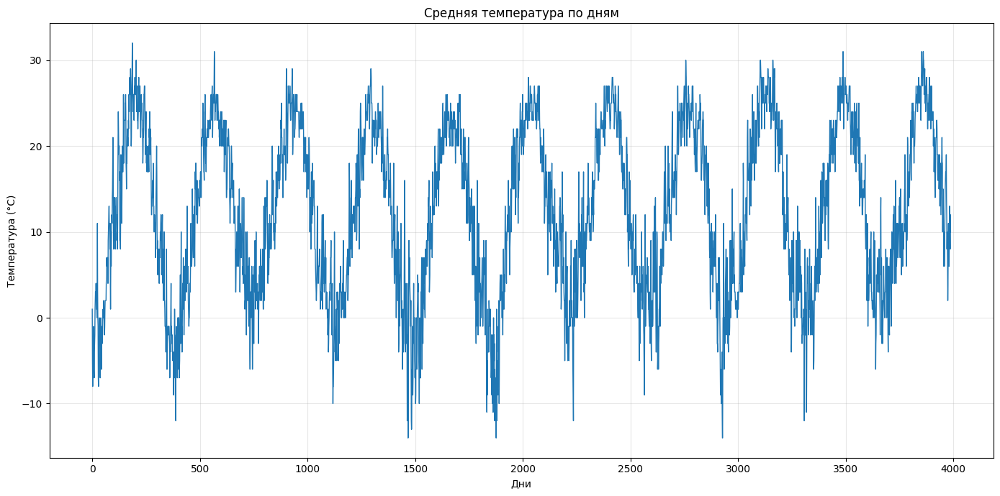

In [214]:
clean_temp = numpy.array([float(t) for t in data_avg_temp_C])

plt.figure(figsize=(14, 7))
plt.plot(range(len(data_x)), clean_temp, linewidth=1)
plt.title('Средняя температура по дням')
plt.xlabel('Дни')
plt.ylabel('Температура (°C)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()